# CIVE7100 project
# Predicting market price

## Preparing packages

In [1]:
#pip install dash

In [2]:
#pip install yfinance   # use yahoo finance as dataReader

In [3]:
#pip install pandas_datareader

## Import dictionary

In [4]:
import numpy as np
import pandas as pd
pd.core.common.is_list_like = pd.api.types.is_list_like
import pandas_datareader as web

import matplotlib.pyplot as plt
import seaborn as sns
sns.set_style('whitegrid')
plt.style.use('fivethirtyeight')
import plotly.express as px
import plotly.graph_objects as go
from plotly.offline import init_notebook_mode
init_notebook_mode(connected = True)
%matplotlib inline

from pandas_datareader.data import DataReader
import yfinance as yf

from datetime import datetime

## Set goal: The top 10 biggest companies in the US (updated to NASDAQ 8/10/2022)

In [5]:
tech_list = ['AAPL', 'MSFT', 'GOOG',  'AMZN', 'V']

end = datetime.now()
start = datetime(2000, 1, 1)

for stock in tech_list:
    globals()[stock] = yf.download(stock, start, end)

[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


In [6]:
company_list = [AAPL, MSFT, GOOG, AMZN, V]
company_name = ['APPLE', 'MICROSOFT', 'GOOGLE', 'AMAZON', 'VISA']

for company, com_name in zip(company_list, company_name):
    company['company_name'] = com_name
    
df = pd.concat(company_list, axis = 0)
df

,Open,High,Low,Close,Adj Close,Volume,company_name
Date,,,,,,,
2000-01-03,0.936384,1.004464,0.907924,0.999442,0.847207,535796800,APPLE
2000-01-04,0.966518,0.987723,0.903460,0.915179,0.775779,512377600,APPLE
2000-01-05,0.926339,0.987165,0.919643,0.928571,0.787131,778321600,APPLE
2000-01-06,0.947545,0.955357,0.848214,0.848214,0.719014,767972800,APPLE
2000-01-07,0.861607,0.901786,0.852679,0.888393,0.753073,460734400,APPLE
...,...,...,...,...,...,...,...
2023-11-27,254.300003,254.979996,252.520004,254.139999,254.139999,5478900,VISA
2023-11-28,253.850006,254.149994,251.610001,252.940002,252.940002,5234900,VISA
2023-11-29,253.919998,256.070007,253.520004,254.229996,254.229996,4955100,VISA


## **Historical view of the closing price**

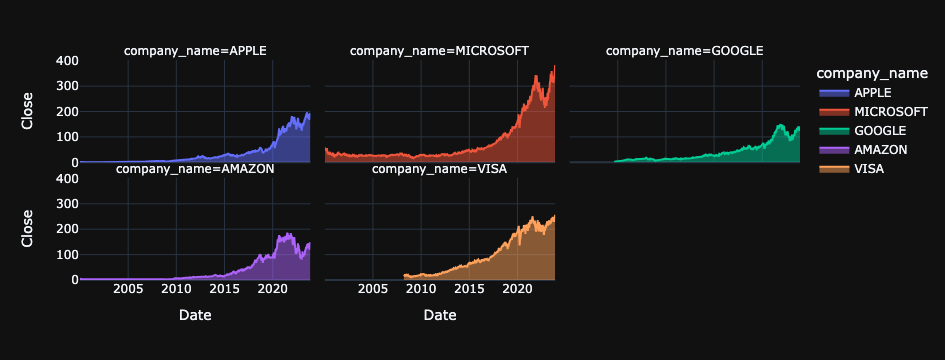

In [7]:
fig = px.area(df, facet_col = 'company_name', x = df.index, y = 'Close', facet_col_wrap = 3, color = 'company_name', template = 'plotly_dark')
fig.show()

## **Sales volume per stock**

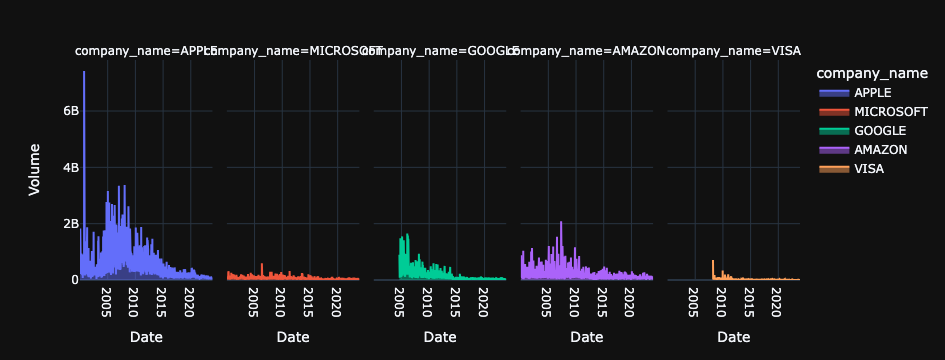

In [8]:
fig = px.area(df, facet_col = 'company_name', x = df.index, y = 'Volume', facet_col_wrap = 5, color = 'company_name', template = 'plotly_dark')
fig.show()

## **Daily return**

In [9]:
df['Daily Return'] = df['Adj Close'].pct_change()

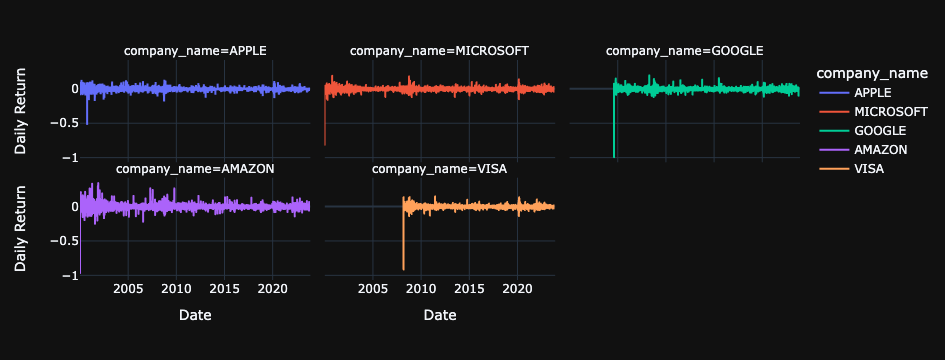

In [10]:
fig = px.line(df, facet_col = 'company_name', x = df.index, y = 'Daily Return', facet_col_wrap = 3, color = 'company_name', template = 'plotly_dark')
fig.show()

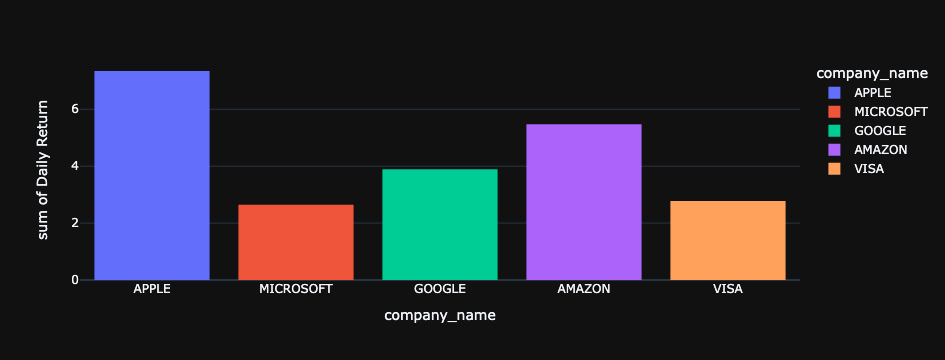

In [11]:
fig = px.histogram(df, x = 'company_name', y = 'Daily Return', color = 'company_name', template = 'plotly_dark')
fig.show()

## **Correlations between stocks**

In [12]:
yf.pdr_override()
# Fetch data from Yahoo Finance
closing_df = yf.download(tech_list, start, end)['Adj Close']

# Display the first few rows of the DataFrame
print(closing_df.head())

[*********************100%%**********************]  5 of 5 completed
                AAPL      AMZN  GOOG       MSFT   V
Date                                               
2000-01-03  0.847207  4.468750   NaN  36.132271 NaN
2000-01-04  0.775779  4.096875   NaN  34.911705 NaN
2000-01-05  0.787131  3.487500   NaN  35.279812 NaN
2000-01-06  0.719014  3.278125   NaN  34.098007 NaN
2000-01-07  0.753073  3.478125   NaN  34.543598 NaN


In [13]:
daily = closing_df.pct_change()
daily.head()

,AAPL,AMZN,GOOG,MSFT,V
Date,,,,,
2000-01-03,NaN,NaN,NaN,NaN,NaN
2000-01-04,-0.084310,-0.083217,NaN,-0.033780,NaN
2000-01-05,0.014633,-0.148741,NaN,0.010544,NaN
2000-01-06,-0.086538,-0.060036,NaN,-0.033498,NaN
2000-01-07,0.047369,0.061010,NaN,0.013068,NaN


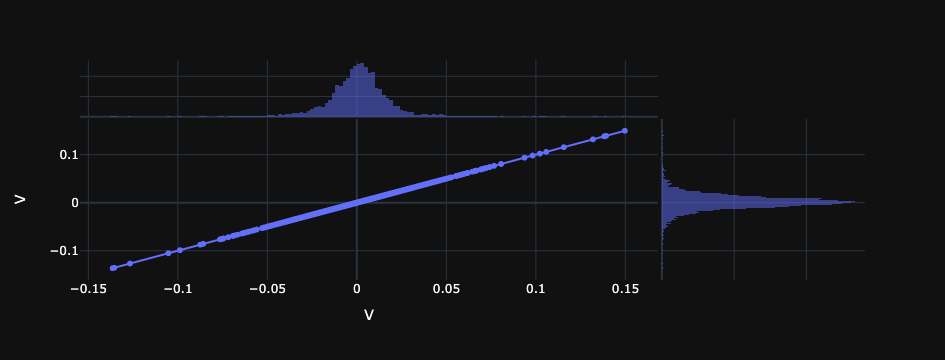

In [14]:
fig = px.scatter(daily, x = 'V', y = 'V', marginal_x = 'histogram', marginal_y = 'histogram', template = 'plotly_dark', trendline = 'ols')
fig.show()

##### **Obviously, there is linearity between Visa and itself.**

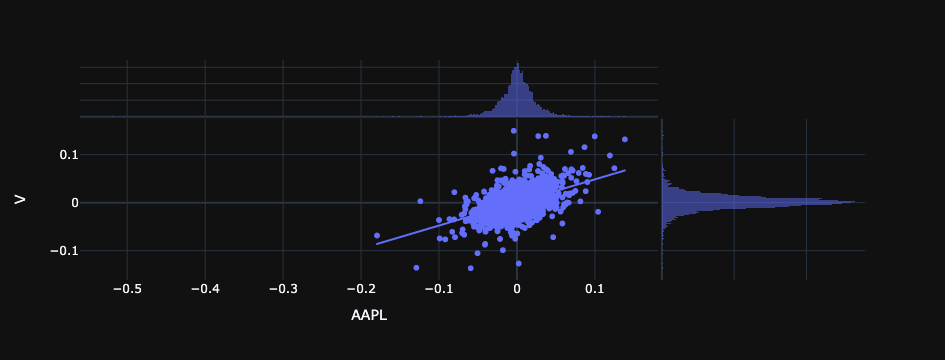

In [15]:
fig = px.scatter(daily, x = 'AAPL', y = 'V', marginal_x = 'histogram', marginal_y = 'histogram', template = 'plotly_dark', trendline = 'ols')
fig.show()

##### **There is a weak and positive correlation between Apple and Visa.**

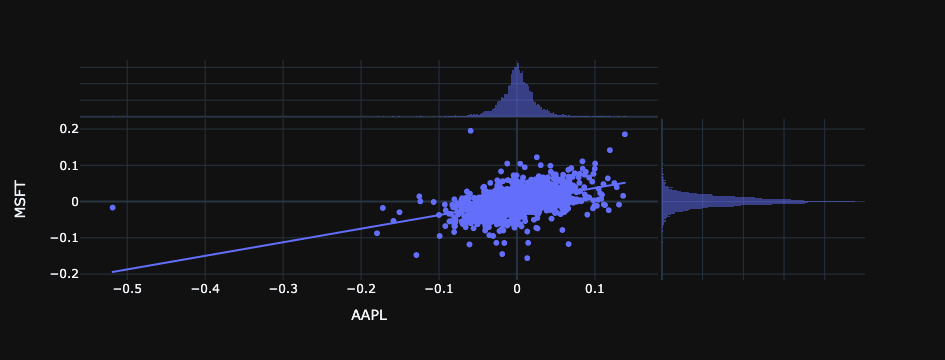

In [16]:
fig = px.scatter(daily, x = 'AAPL', y = 'MSFT', marginal_x = 'histogram', marginal_y = 'histogram', template = 'plotly_dark', trendline = 'ols')
fig.show()

##### **There is a weak positive correlation between Apple and Microsoft**

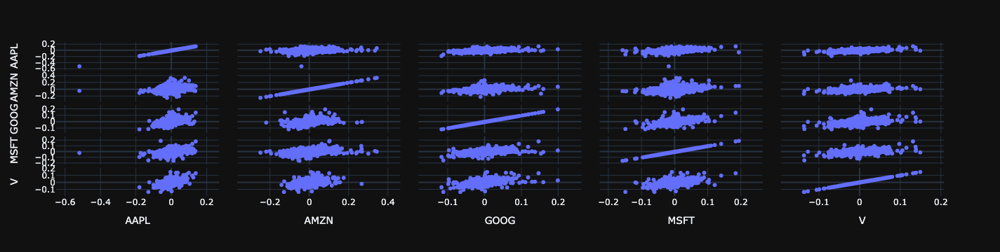

In [17]:
fig = px.scatter_matrix(daily, template = 'plotly_dark')
fig.show()

<Axes: >

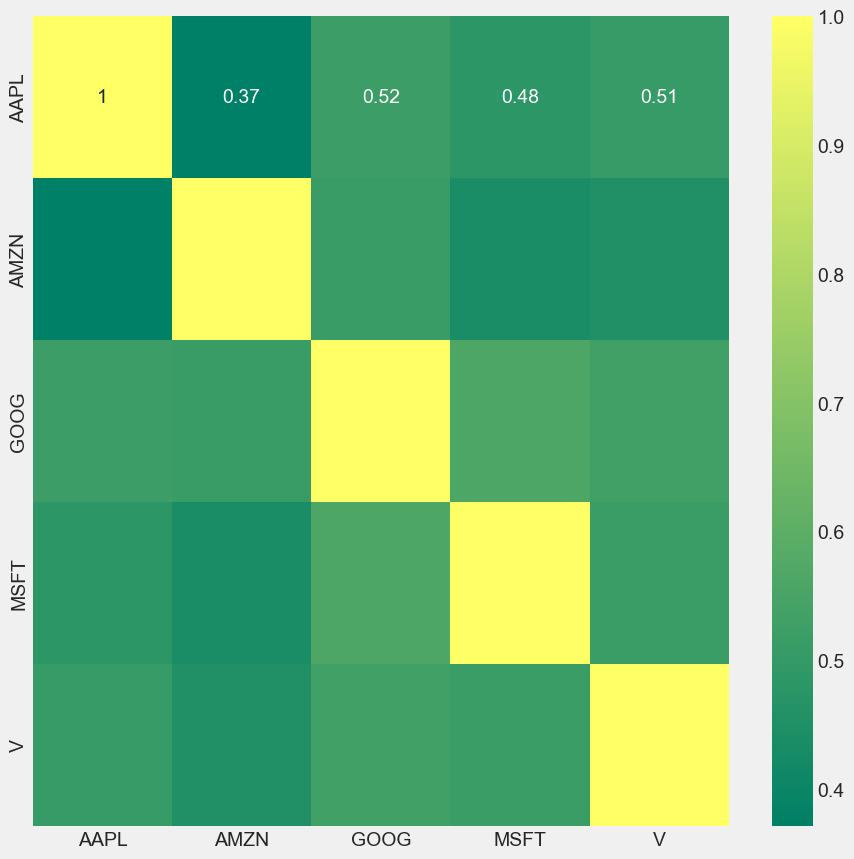

In [18]:
plt.figure(figsize = (10, 10))
sns.heatmap(daily.corr(), annot = True, cmap = 'summer')

##### **The highest correlation to daily returns is between Google and Microsoft, i.e. there is a weak positive correlation of 0.55**

## **Risk and return**

In [19]:
risk = daily.dropna()

In [20]:
area = np.pi * 20

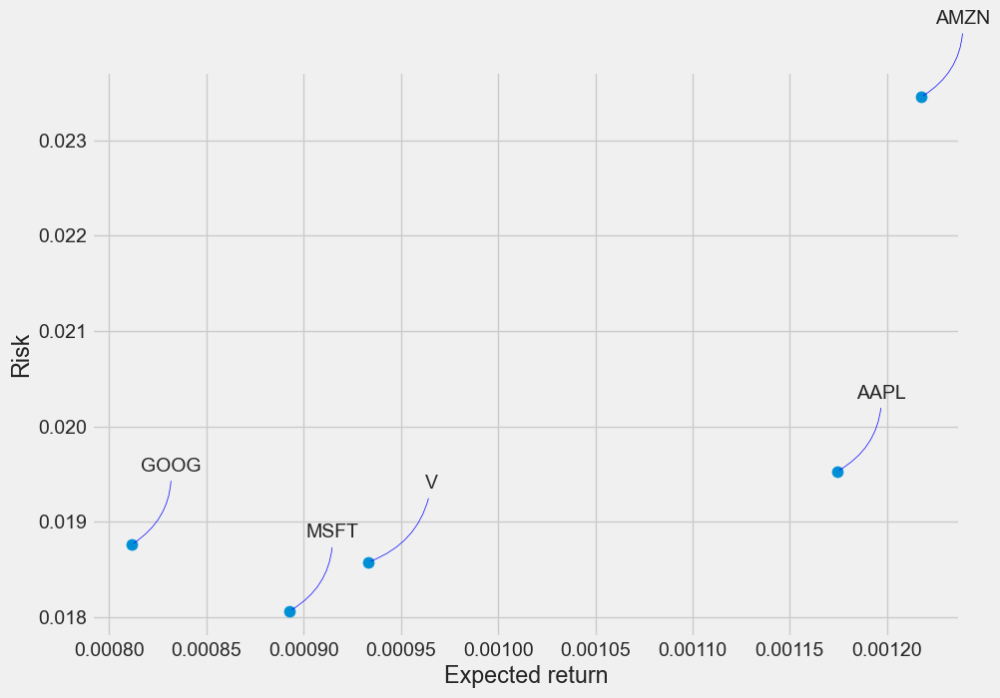

In [21]:
plt.figure(figsize=(10, 7))
plt.scatter(risk.mean(), risk.std(), s=area)
plt.xlabel('Expected return')
plt.ylabel('Risk')

for label, x, y in zip(risk.columns, risk.mean(), risk.std()):
    plt.annotate(label, xy=(x, y), xytext=(50, 50), textcoords='offset points', ha='right', va='bottom', 
                 arrowprops=dict(arrowstyle='-', color='blue', connectionstyle='arc3,rad=-0.3'))

##### **Netflix has a high return but a high risk, while Apple has a high return for a moderate risk, so it would be worth investing in Apple if you have the moderate profile.**

## **Predicting AAPL's closing price**

In [56]:
# Define the stock symbol for S&P 500
symbol_sp500 = '^GSPC'

# Define start and end dates
start_date_sp500 = '2000-01-01'
end_date_sp500 = datetime.now()

# Fetch historical data for S&P 500 from Yahoo Finance
df2 = yf.download(symbol_sp500, start=start_date_sp500, end=end_date_sp500)

# Display the DataFrame
print(df2)


[*********************100%%**********************]  1 of 1 completed
                   Open         High          Low        Close    Adj Close  \
Date                                                                          
2000-01-03  1469.250000  1478.000000  1438.359985  1455.219971  1455.219971   
2000-01-04  1455.219971  1455.219971  1397.430054  1399.420044  1399.420044   
2000-01-05  1399.420044  1413.270020  1377.680054  1402.109985  1402.109985   
2000-01-06  1402.109985  1411.900024  1392.099976  1403.449951  1403.449951   
2000-01-07  1403.449951  1441.469971  1400.729980  1441.469971  1441.469971   
...                 ...          ...          ...          ...          ...   
2023-11-27  4554.859863  4560.520020  4546.319824  4550.430176  4550.430176   
2023-11-28  4545.549805  4568.140137  4540.509766  4554.890137  4554.890137   
2023-11-29  4571.839844  4587.640137  4547.149902  4550.580078  4550.580078   
2023-11-30  4554.870117  4569.890137  4537.240234  4567.799805

## Method (OHLC)

In [57]:
fig = go.Figure(data=[go.Candlestick(x=df2.index,
                open=df2['Open'],
                high=df2['High'],
                low=df2['Low'],
                close=df2['Close'])])

fig.show()

## Training/testing spliting
### Training/Testing ratio: 8:2

In [58]:
data = df2.filter(['Close'])
dataset = data.values
training_data_len = int(np.ceil( len(dataset) * .80 ))
training_data_len


4815

## Data Preporcessing

In [59]:
from sklearn.preprocessing import MinMaxScaler

scaler = MinMaxScaler(feature_range=(0,1))
scaled_data = scaler.fit_transform(dataset)

scaled_data

array([[0.18900104],
       [0.17545746],
       [0.17611036],
       ...,
       [0.94029656],
       [0.94447607],
       [0.95098818]])

In [60]:
train_data = scaled_data[0:int(training_data_len), :]

x_train = []
y_train = []

for i in range(60, len(train_data)):
    x_train.append(train_data[i-60:i, 0])
    y_train.append(train_data[i, 0])
    if i<= 61:
        print(x_train)
        print(y_train)
        print()
        
x_train, y_train = np.array(x_train), np.array(y_train)

x_train = np.reshape(x_train, (x_train.shape[0], x_train.shape[1], 1))    # data reshaping

[array([0.18900104, 0.17545746, 0.17611036, 0.17643559, 0.18566368,
       0.1895787 , 0.1849574 , 0.18342584, 0.18765641, 0.19141123,
       0.18898163, 0.1891661 , 0.18665881, 0.18563699, 0.17596959,
       0.17803268, 0.17659093, 0.17524873, 0.1659284 , 0.17425357,
       0.17785065, 0.1778118 , 0.18165886, 0.18151323, 0.18148168,
       0.18572436, 0.17844043, 0.17968314, 0.17247204, 0.17315648,
       0.17609581, 0.17260554, 0.17274874, 0.16251336, 0.1639891 ,
       0.16605702, 0.16429492, 0.15942358, 0.16298911, 0.16744781,
       0.17054728, 0.17117108, 0.17782395, 0.17348175, 0.16482646,
       0.16751575, 0.1760084 , 0.17440162, 0.17162253, 0.16568326,
       0.17369048, 0.18978986, 0.19124616, 0.18934327, 0.19838204,
       0.20002524, 0.20650819, 0.20653489, 0.20566111, 0.20174609])]
[0.20193784616088406]

[array([0.18900104, 0.17545746, 0.17611036, 0.17643559, 0.18566368,
       0.1895787 , 0.1849574 , 0.18342584, 0.18765641, 0.19141123,
       0.18898163, 0.1891661 , 0.18

In [61]:
from keras.models import Sequential
from keras.layers import Dense, LSTM

# Build the LSTM model
model = Sequential()
model.add(LSTM(128, return_sequences=True, input_shape= (x_train.shape[1], 1)))
model.add(LSTM(64, return_sequences=False))
model.add(Dense(25))
model.add(Dense(1))

# Compile the model
model.compile(optimizer='adam', loss='mean_squared_error')

# Train the model
model.fit(x_train, y_train, batch_size=1, epochs=10)

Epoch 1/10


2023-12-02 21:34:19.872061: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2023-12-02 21:34:19.872715: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2023-12-02 21:34:19.873459: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

4755/4755 [==============================] - 50s 10ms/step - loss: 2.0503e-04
Epoch 2/10
4755/4755 [==============================] - 49s 10ms/step - loss: 9.3304e-05
Epoch 3/10
4755/4755 [==============================] - 50s 10ms/step - loss: 7.3464e-05
Epoch 4/10
4755/4755 [==============================] - 50s 10ms/step - loss: 7.0082e-05
Epoch 5/10
4755/4755 [==============================] - 50s 11ms/step - loss: 5.9818e-05
Epoch 6/10
4755/4755 [==============================] - 50s 10ms/step - loss: 5.0223e-05
Epoch 7/10
4755/4755 [==============================] - 50s 10ms/step - loss: 5.0340e-05
Epoch 8/10
4755/4755 [==============================] - 50s 10ms/step - loss: 4.5516e-05
Epoch 9/10
4755/4755 [==============================] - 50s 10ms/step - loss: 4.3690e-05
Epoch 10/10
4755/4755 [==============================] - 50s 11ms/step - loss: 4.2119e-05


In [62]:
# Create the testing data set
# Create a new array containing scaled values from index 1543 to 2002 
test_data = scaled_data[training_data_len - 60: , :]
# Create the data sets x_test and y_test
x_test = []
y_test = dataset[training_data_len:, :]
for i in range(60, len(test_data)):
    x_test.append(test_data[i-60:i, 0])
    
# Convert the data to a numpy array
x_test = np.array(x_test)

# Reshape the data
x_test = np.reshape(x_test, (x_test.shape[0], x_test.shape[1], 1 ))

# Get the models predicted price values 
predictions = model.predict(x_test)
predictions = scaler.inverse_transform(predictions)

# Get the root mean squared error (RMSE)
rmse = np.sqrt(np.mean(((predictions - y_test) ** 2)))
rmse

 1/38 [..............................] - ETA: 9s

2023-12-02 21:42:38.413751: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2023-12-02 21:42:38.414322: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2023-12-02 21:42:38.414872: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

38/38 [==============================] - 1s 13ms/step


94.81587493076977

# Validation set

In [63]:
train = data[:training_data_len]
valid = data[training_data_len:]
valid['Predictions'] = predictions

/var/folders/1g/0mj97r555d15d54dx2257j7m0000gn/T/ipykernel_5142/2657761684.py:3: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



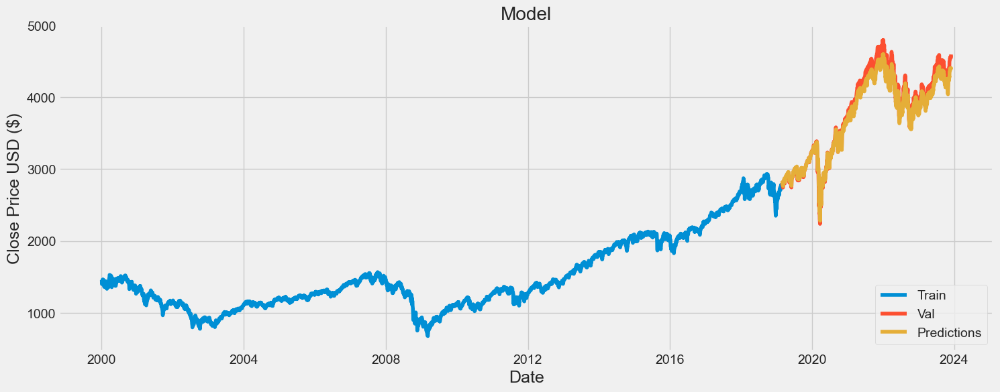

In [64]:
plt.figure(figsize=(16,6))
plt.title('Model')
plt.xlabel('Date', fontsize=18)
plt.ylabel('Close Price USD ($)', fontsize=18)
plt.plot(train['Close'])
plt.plot(valid[['Close', 'Predictions']])
plt.legend(['Train', 'Val', 'Predictions'], loc='lower right')
plt.show()

In [65]:
valid

,Close,Predictions
Date,,
2019-02-25,2796.110107,2809.603027
2019-02-26,2793.899902,2811.175293
2019-02-27,2792.379883,2810.536621
2019-02-28,2784.489990,2809.467285
2019-03-01,2803.689941,2802.038330
...,...,...
2023-11-27,4550.430176,4406.194336
2023-11-28,4554.890137,4400.346191
2023-11-29,4550.580078,4404.474609


In [66]:
# Reset the index in the 'valid' DataFrame
valid.reset_index(inplace=True);
valid['Date'] = pd.to_datetime(valid['Date']).copy()

/var/folders/1g/0mj97r555d15d54dx2257j7m0000gn/T/ipykernel_5142/2336435200.py:3: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [67]:
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import plotly.io as pio
import numba as nb

pio.renderers.default='svg'

TS_LENGTH = 20  # How long the dynamic time-warping comparison is
PLOT_FROM = '01-01-01'  # Where to plot the comparison from
DTW_THRESHOLD = 11.53

@nb.jit(nopython = True)
def z_scale(ts: np.array) -> np.array:
    return (ts - np.mean(ts))/np.std(ts)


@nb.jit(nopython=True)
def get_dtw_score(ts1: np.ndarray, ts2: np.ndarray) -> float:
    '''
    Calculate the dynamic time warping cost between two time series
    '''
    C = np.full(shape=(ts1.shape[0] + 1, ts2.shape[0] + 1), fill_value=np.inf)
    C[0, 0] = 0

    for i in range(1, ts1.shape[0] + 1):
        for j in range(1, ts2.shape[0] + 1):
            dist = abs(ts1[i-1] - ts2[j-1])
            prev_min = min(C[i-1, j], C[i, j-1], C[i-1, j-1])
            C[i, j] = dist + prev_min

    return C[-1, -1]

# Explicitly define the type signature for rolling_score_inner_loop
@nb.jit(nopython=True)
def rolling_score_inner_loop(ts1: np.ndarray, ts2: np.ndarray, length: int) -> np.ndarray:
    scores = np.full(ts1.shape, np.nan)

    for n in range(length, ts1.shape[0]):
        scores[n] = get_dtw_score(
            ts1=z_scale(ts1[n - length:n]),
            ts2=z_scale(ts2[n - length:n]),
        )

    return scores

# Explicitly define the type signature for rolling_score
@nb.jit(nopython=True)
def rolling_score(ts1: np.array, ts2: np.array, length: int) -> np.array:
    scores = np.full(ts1.shape, np.nan)

    for n in range(length, ts1.shape[0]):
        ts1_window = z_scale(ts1[n - length:n] + 1e-8)
        ts2_window = z_scale(ts2[n - length:n] + 1e-8)
        score = get_dtw_score(ts1_window, ts2_window)
        scores[n] = score

    return scores


In [68]:
# Extract necessary columns from the 'valid' DataFrame
dtw_frame = valid[['Date', 'Close', 'Predictions']].copy()

# Calculate DTW scores and add to the 'dtw_frame' DataFrame
dtw_frame['DTW_score'] = rolling_score(
    ts1=dtw_frame['Predictions'].values.astype(np.float64),
    ts2=dtw_frame['Close'].values.astype(np.float64),
    length=TS_LENGTH,
)

# Display the 'dtw_frame'
print(dtw_frame.tail())

           Date        Close  Predictions  DTW_score
1198 2023-11-27  4550.430176  4406.194336   2.711663
1199 2023-11-28  4554.890137  4400.346191   2.506173
1200 2023-11-29  4550.580078  4404.474609   2.691144
1201 2023-11-30  4567.799805  4400.422363   2.711819
1202 2023-12-01  4594.629883  4414.696777   3.361291


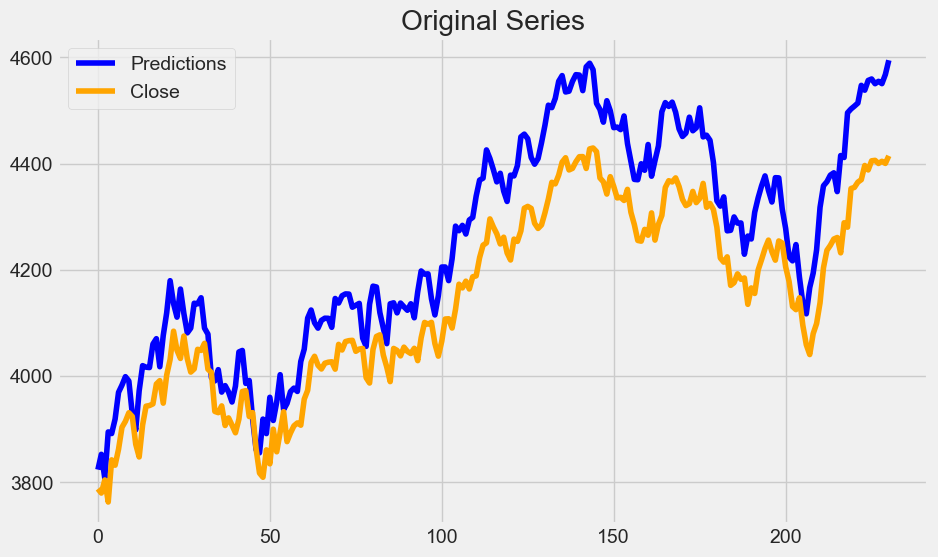

--------------------------------------------------
Minimum Distance: 11668.504150390625	Normalized Distance: 25.256502490023


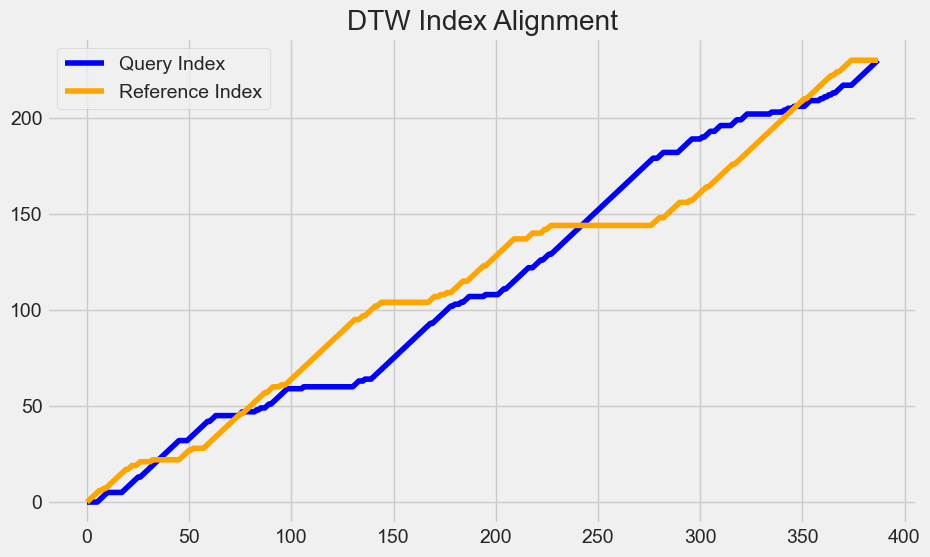

--------------------------------------------------


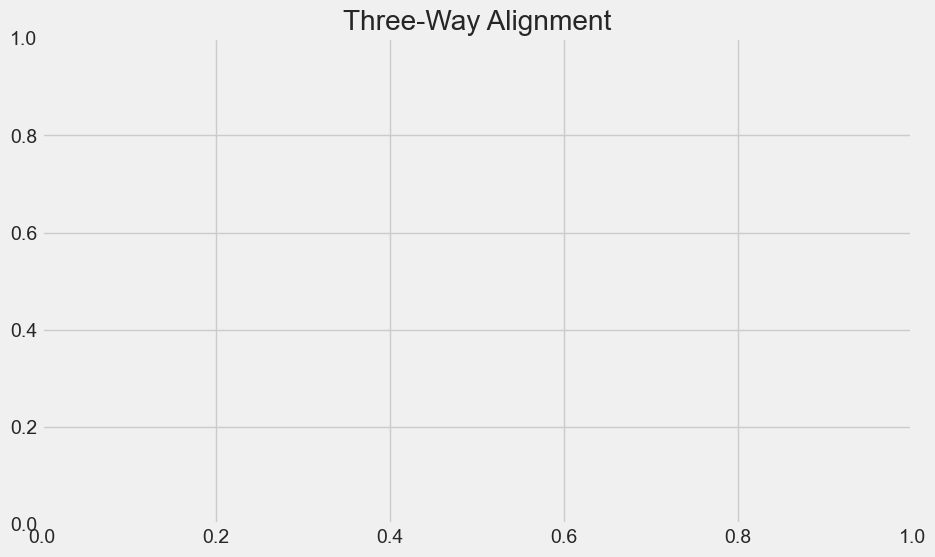

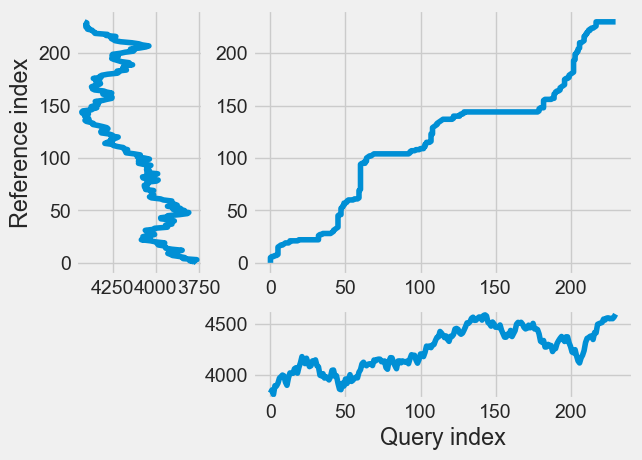

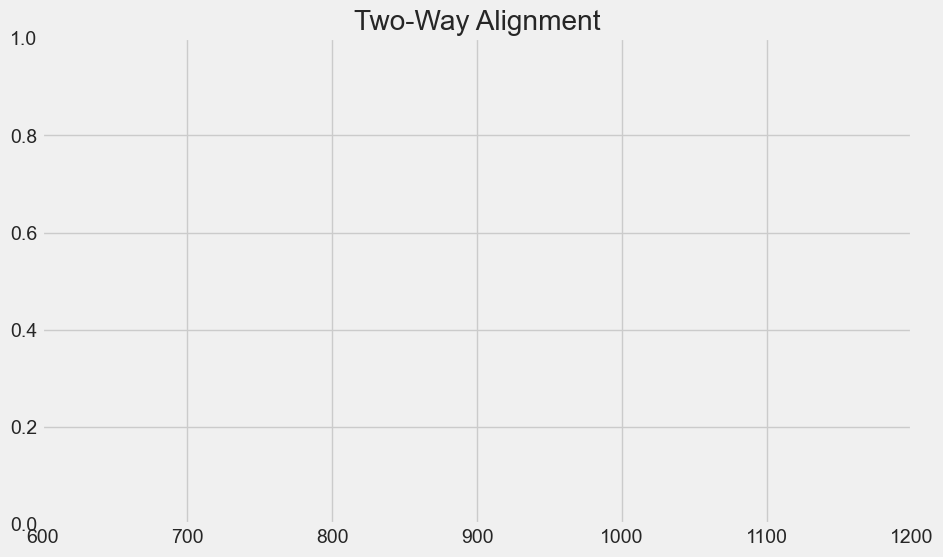

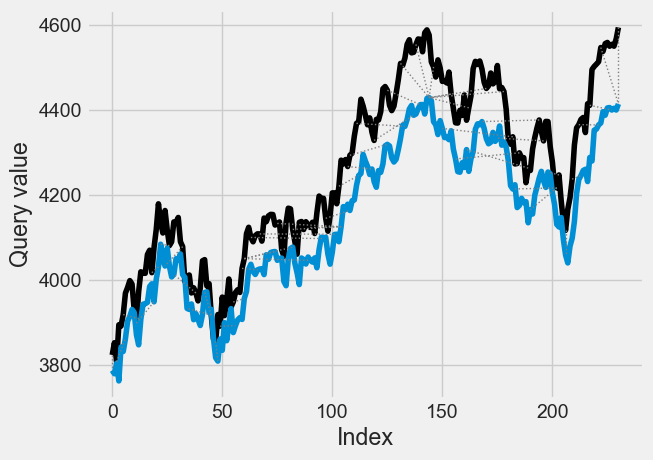

AttributeError: Line2D.set() got an unexpected keyword argument 'xlim'

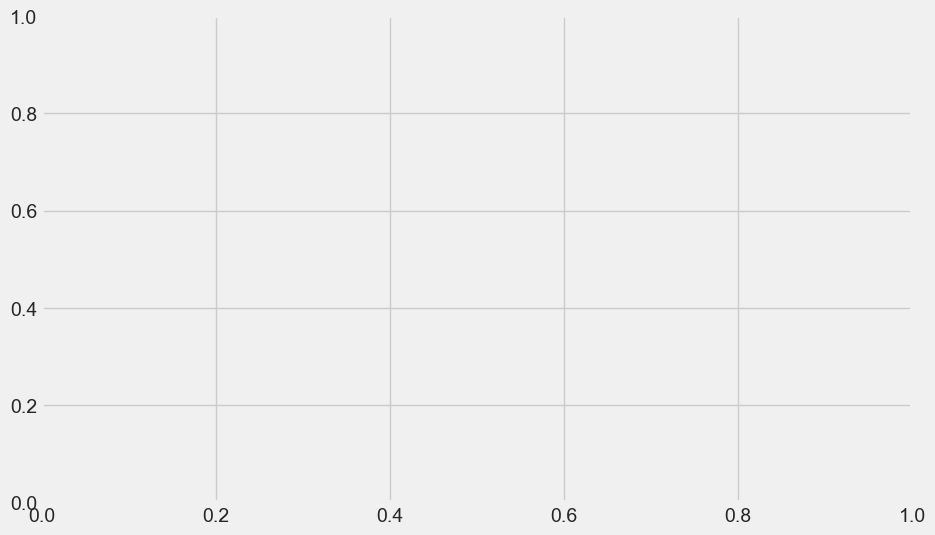

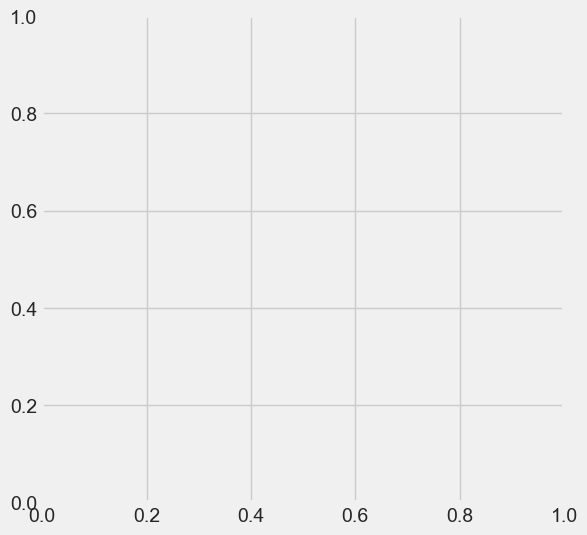

In [69]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from dtw import *

def get_dtw(query, reference, zoom_start=600, zoom_end=1200, verbose=True):
    # Plot original series
    fig, ax = plt.subplots(figsize=(10, 6))
    ax.plot(query, label='Predictions', color='blue')
    ax.plot(reference, label='Close', color='orange')
    ax.legend()
    ax.set_title('Original Series')
    plt.show()

    print('-'*50)

    # Calculate and plot DTW
    al = dtw(query, reference, keep_internals=True)
    print(f'Minimum Distance: {al.distance}\tNormalized Distance: {al.normalizedDistance}')

    # Plot Query and Reference Indices
    fig, ax = plt.subplots(figsize=(10, 6))
    ax.plot(al.index1, label='Query Index', color='blue')
    ax.plot(al.index2, label='Reference Index', color='orange')
    ax.legend()
    ax.set_title('DTW Index Alignment')
    plt.show()

    print('-'*50)

    # Plot Three-Way Alignment
    fig, ax = plt.subplots(figsize=(10, 6))
    al.plot(type='threeway', axis=ax)
    ax.set_title('Three-Way Alignment')
    plt.show()

    # Plot Two-Way Alignment with Zoom
    fig, ax = plt.subplots(figsize=(10, 6))
    al.plot(type='twoway', xts=query.reset_index(drop=True), yts=reference.reset_index(drop=True))
    ax.set_title('Two-Way Alignment')
    ax.set_xlim(zoom_start, zoom_end)
    plt.show()

    # Plot Alignment with Zoom
    fig, ax = plt.subplots(figsize=(10, 6))
    al.plot(type='alignment', xlim=(zoom_start, zoom_end))
    ax.set_title('Alignment Zoomed In')
    plt.show()

    print('='*50)

# Assuming 'dtw_frame' DataFrame with 'Date', 'Close', 'Predictions', and 'DTW_score' columns
start_date = '2023-01-01'
end_date = '2023-12-01'

filtered_dtw_frame = dtw_frame[(dtw_frame['Date'] >= start_date) & (dtw_frame['Date'] <= end_date)].reset_index(drop=True)

get_dtw(filtered_dtw_frame['Close'], filtered_dtw_frame['Predictions'])


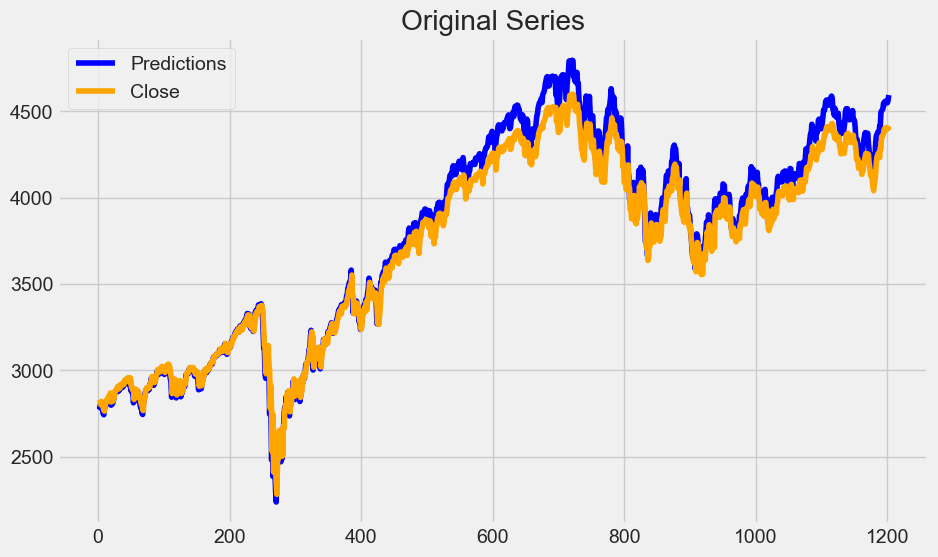

--------------------------------------------------
Minimum Distance: 44187.061767578125	Normalized Distance: 18.365362330664226


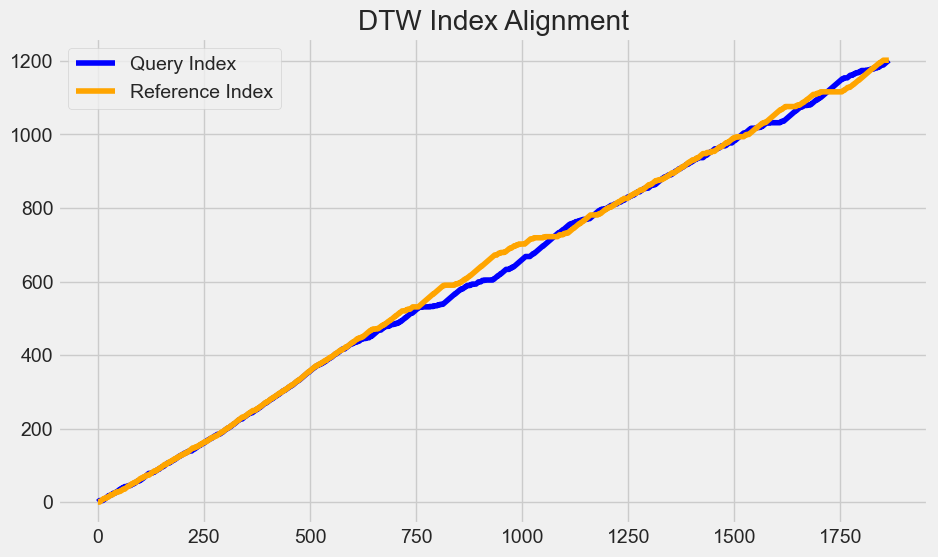

--------------------------------------------------


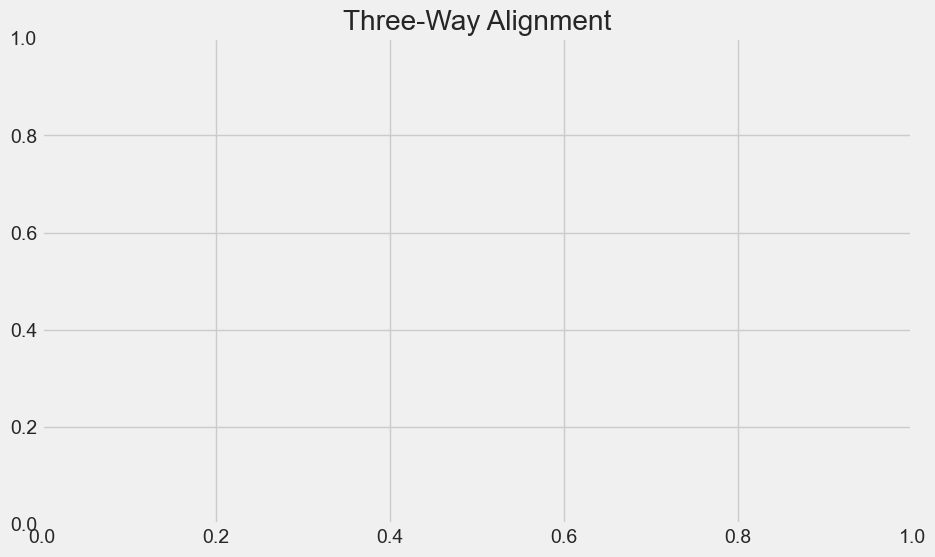

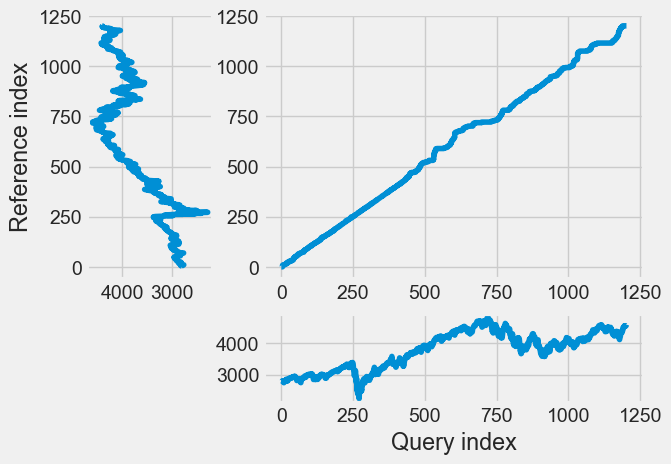

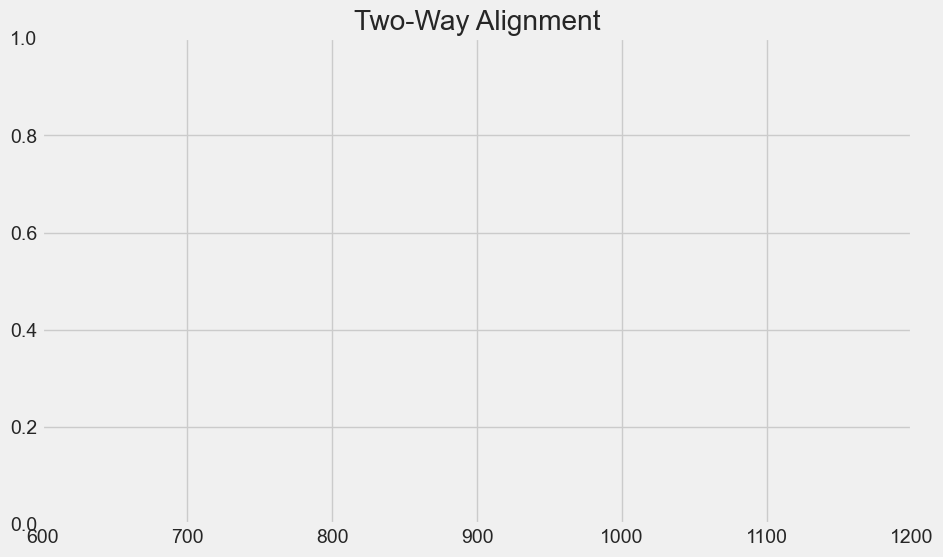

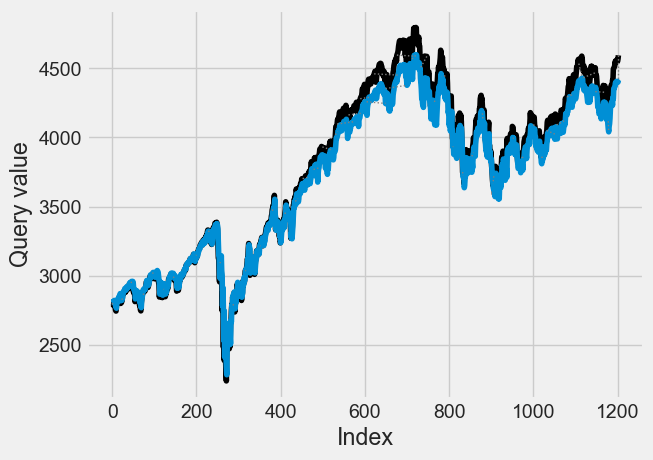

AttributeError: Line2D.set() got an unexpected keyword argument 'xlim'

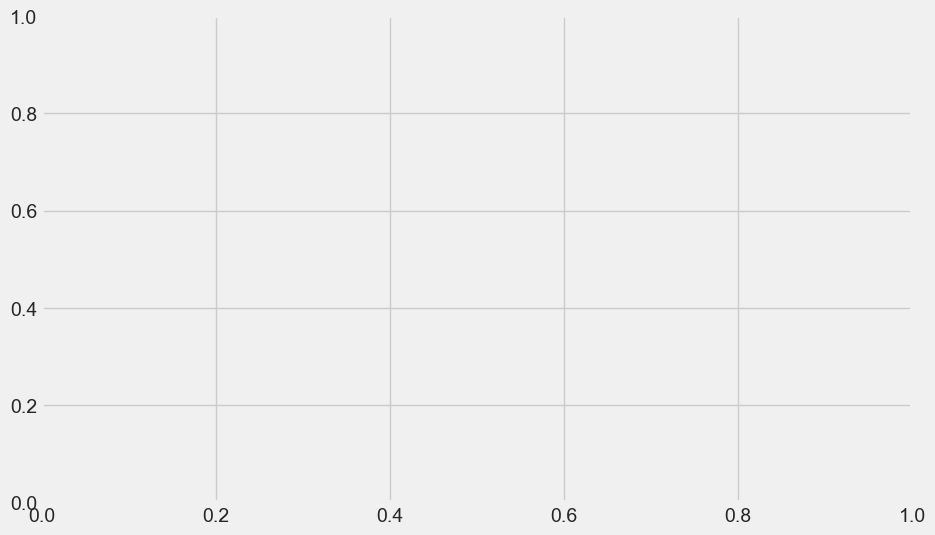

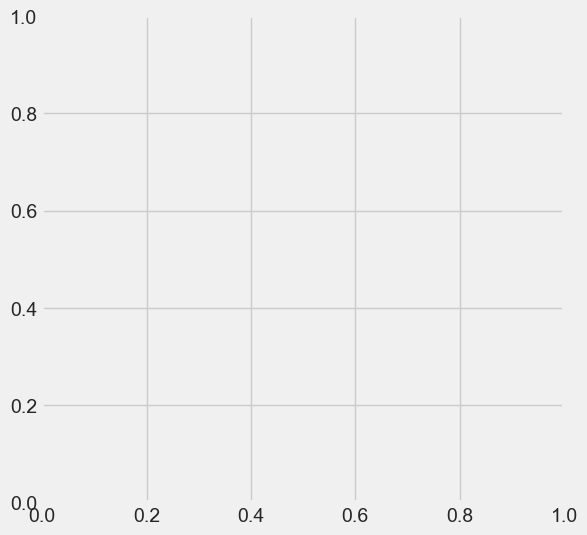

In [70]:
get_dtw(dtw_frame['Close'], dtw_frame['Predictions'])

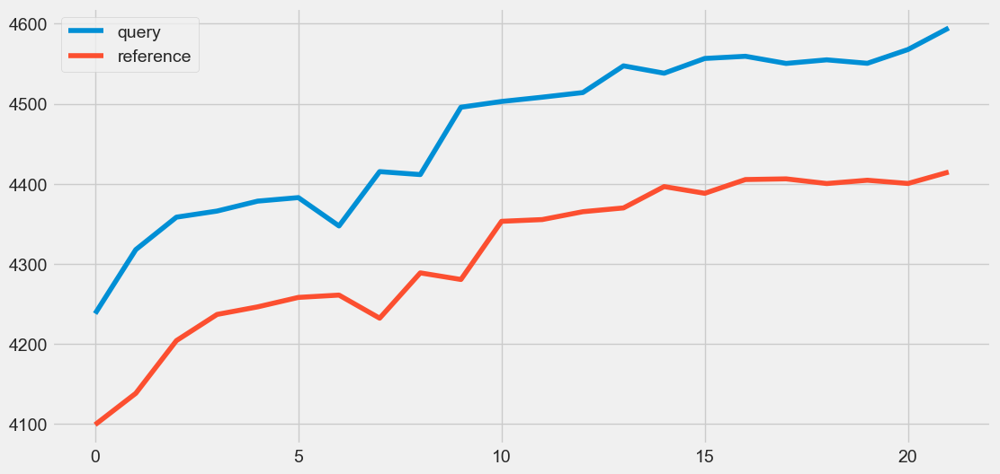

----------
[minimum distance]: 2235.84521484375	[normalized distance]: 50.81466397372159


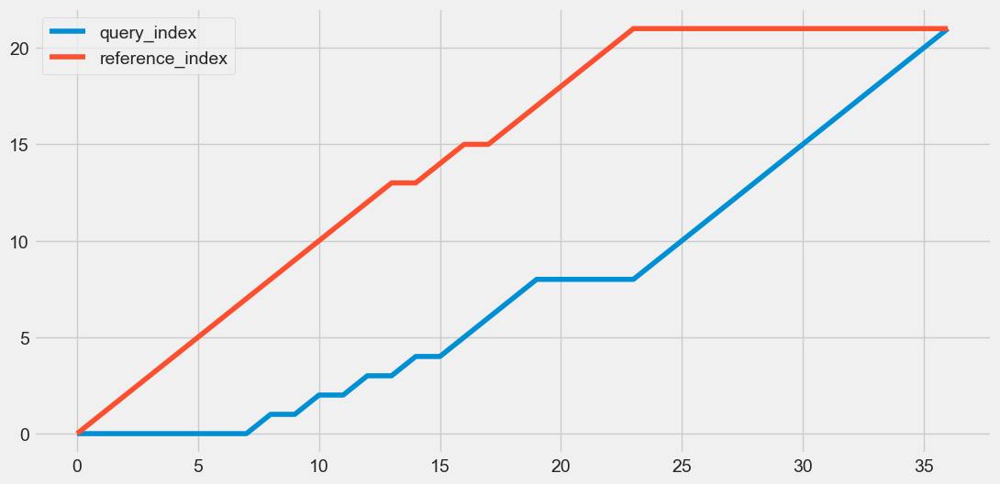

----------


AttributeError: Line2D.set() got an unexpected keyword argument 'xlim'

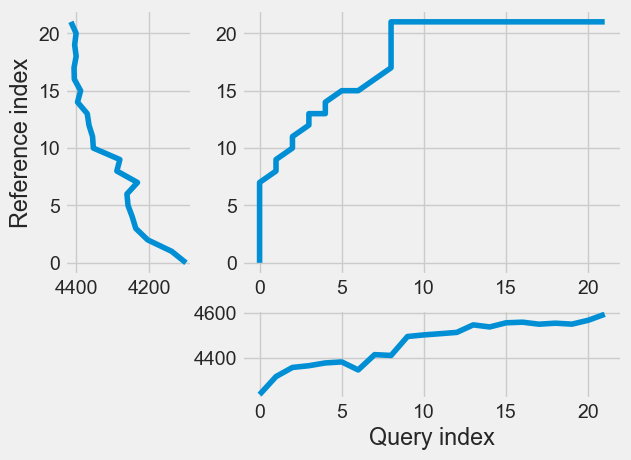

<Figure size 1200x600 with 0 Axes>

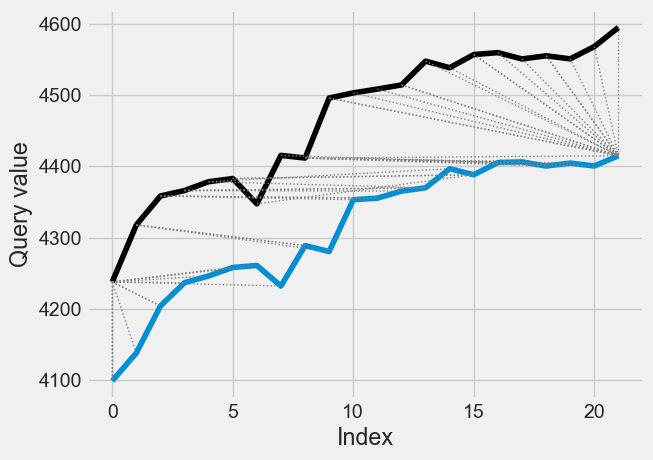

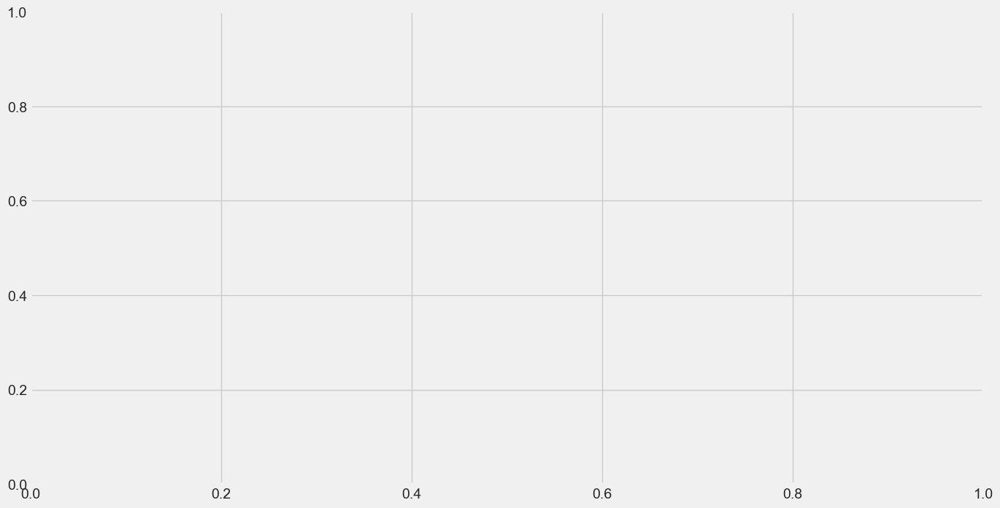

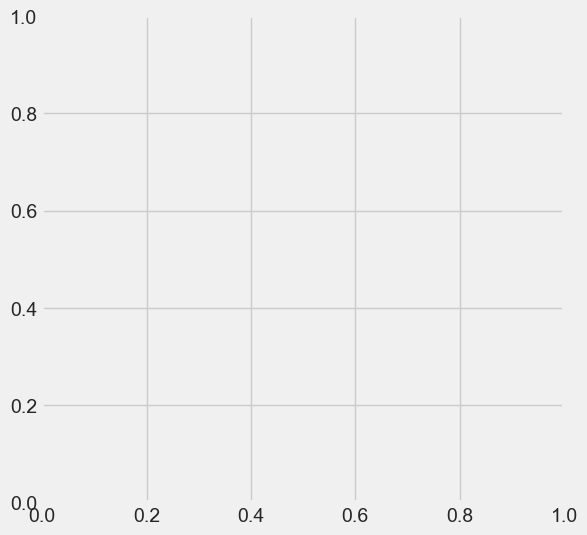

In [80]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from dtw import *

def get_dtw(query, reference, zoom_start=600, zoom_end=1200, verbose=True):
    # Increase the figure size for better visibility
    fig = plt.figure(figsize=(12, 6))
    plt.plot(query)
    plt.plot(reference)
    plt.legend(['query', 'reference'])
    plt.show()

    print('-'*10)

    al = dtw(query, reference, keep_internals=True)
    print('[minimum distance]: {0}\t[normalized distance]: {1}'.format(al.distance, al.normalizedDistance))

    # Increase the figure size for better visibility
    fig = plt.figure(figsize=(12, 6))
    plt.plot(al.index1)
    plt.plot(al.index2)
    plt.legend(['query_index', 'reference_index'])
    plt.show()
    print('-'*10)

    al.plot(type='threeway')

    # Increase the figure size for better visibility
    fig = plt.figure(figsize=(12, 6))
    al.plot(type='twoway', xts=query.reset_index(drop=True), yts=reference.reset_index(drop=True))

    # Zoom in on the 4th plot from index 600 to 1200
    # Increase the figure size for better visibility
    fig, ax = plt.subplots(figsize=(15, 8))
    al.plot(type='alignment', xlim=(zoom_start, zoom_end), ax=ax)
    plt.show()

    print('='*10)

# Assuming 'dtw_frame' DataFrame with 'Date', 'Close', 'Predictions', and 'DTW_score' columns
start_date = '2023-11-01'
end_date = '2023-12-01'

filtered_dtw_frame = dtw_frame[(dtw_frame['Date'] >= start_date) & (dtw_frame['Date'] <= end_date)].reset_index(drop=True)

get_dtw(filtered_dtw_frame['Close'], filtered_dtw_frame['Predictions'])
